## Please note i am keeping only the final code that is used in this file. Other EDA, and different trial of failed approaches is done in a separate file for reference

## Kindly see the cell outputs for reference. 

### Please make sure you have efficient net model downloaded or else download using this command in jupyter cell 
pip install efficientnet-pytorch

In [6]:
import torch
from torchvision import transforms
from efficientnet_pytorch import EfficientNet
from torch.utils.data import Dataset, DataLoader
import numpy as np
from scipy.linalg import inv
from sklearn.metrics import accuracy_score
from sklearn.decomposition import PCA
import pickle
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd 
import warnings
warnings.filterwarnings('ignore')
# tranformations on the data for efficientnet
transform = transforms.Compose([
    transforms.ToPILImage(),transforms.Resize((224, 224)),transforms.ToTensor(),  
    transforms.Normalize(mean=[0.485, 0.456, 0.406],std=[0.229, 0.224, 0.225])])

class EfficientNetDataset(Dataset):
    def __init__(self,images,transform=None):
        self.images=images
        self.transform=transform
    def __len__(self):
        return len(self.images)
    def __getitem__(self,idx):
        img=self.images[idx]
        if self.transform:
            img=self.transform(img)
        return img
model = EfficientNet.from_pretrained('efficientnet-b0')
model.eval() # model for feature extraction
with open(f'task_1_models/efficient/model.pkl','wb') as f:
    pickle.dump(model,f)
# Setting to cuda for speeding up, still keeping cpu code ready in case this file is being tested on a system that does not have gpu
device = torch.device("cuda" if torch.cuda.is_available() else "mps" if torch.backends.mps.is_available() else "cpu")
model.to(device)


Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b0-355c32eb.pth" to /Users/aryanagarwal/.cache/torch/hub/checkpoints/efficientnet-b0-355c32eb.pth
100%|███████████████████████████████████████| 20.4M/20.4M [00:25<00:00, 830kB/s]


Loaded pretrained weights for efficientnet-b0
torch.Size([2500, 1280])


In [67]:
# saved model for reference as well and task 2
with open(f'task_1_models/efficient/model.pkl','wb') as f:
    pickle.dump(model,f)

In [ ]:
def compute_class_prototypes(features,labels):
    unique_labels=np.unique(labels)
    prototypes={}
    for label in unique_labels:
        class_features = features[labels==label]
        prototypes[label]=np.mean(class_features,axis=0)  # Compute mean
    return prototypes

def mahalanobis_distance(x, mean, cov_matrix):
    diff= x - mean
    inv_cov=inv(cov_matrix)
    return np.sqrt(diff.T @ inv_cov @ diff)

In [64]:
def predict_lwp(features, prototypes, inv_cov_matrix):
    predictions = []
    for feature in features:
        distances = []
        for label, mean in prototypes.items():
            diff = feature - mean
            dist = np.sqrt(diff.T @ inv_cov_matrix @ diff)
            distances.append((label, dist))
        predictions.append(min(distances, key=lambda x: x[1])[0])
    return np.array(predictions)

In [29]:
def get_features_group13(file_path):
    #file_path="dataset/part_one_dataset/train_data/1_train_data.tar.pth"
    d=torch.load(file_path)
    data=d['data']  
    images=data  
    dataset=EfficientNetDataset(images, transform=transform)
    dataloader=DataLoader(dataset, batch_size=64, shuffle=False)
    features=[]
    for batch in dataloader:
        batch=batch.to(device)
        with torch.no_grad():
            feature_batch=model.extract_features(batch)  # trainign in batches to speed up 
            feature_batch=feature_batch.mean(dim=[2,3])  #Average pooling
            features.append(feature_batch.cpu())  
    features=torch.cat(features,dim=0)
    return features


In [66]:
# training
for data_set_num in [1,2,3,4,5,6,7,8,9,10]:
    print(data_set_num)
    features=get_features_group13(f'dataset/part_one_dataset/train_data/{data_set_num}_train_data.tar.pth')
    if data_set_num==1:
        d=torch.load(f'dataset/part_one_dataset/train_data/{data_set_num}_train_data.tar.pth')
        labels=d['targets']
    else:
        labels=next_targets
    if data_set_num==1:
        pca=PCA(n_components=150)  # Reduce dimensions to 50
        reduced_features=pca.fit_transform(features)
    else:
        reduced_features=pca.transform(features)
    inv_cov_matrix=inv(np.cov(reduced_features, rowvar=False))  
    prototypes=compute_class_prototypes(reduced_features, labels)
    
    if data_set_num!=1:
        # Weighted Update
        prototypes=((pd.Series(old_prototypes)*0.8) + (pd.Series(prototypes)*0.2)).to_dict()
        inv_cov_matrix=old_inv_cov_matrix*0.8 + inv_cov_matrix*0.2
        print(prototypes.keys())
    
    # save models
    if data_set_num==1:
        with open(f'task_1_models/efficient/single/pca_{data_set_num}.pkl','wb') as f:
            pickle.dump(pca,f)    
    with open(f'task_1_models/efficient/single/cov_{data_set_num}.pkl','wb') as f:
        pickle.dump(inv_cov_matrix,f)
    with open(f'task_1_models/efficient/single/prototypes_{data_set_num}.pkl','wb') as f:
        pickle.dump(prototypes,f)
    predictions=predict_lwp(reduced_features,prototypes,inv_cov_matrix)
    accuracy=accuracy_score(labels,predictions)
    print(f"Training Accuracy Dataset {data_set_num}: {accuracy}")

    # next pred
    if data_set_num!=10:
        features=get_features_group13(f'dataset/part_one_dataset/train_data/{data_set_num+1}_train_data.tar.pth')
        reduced_features=pca.transform(features)
        next_targets=predict_lwp(reduced_features, prototypes, inv_cov_matrix)
        old_prototypes=prototypes.copy()
        old_inv_cov_matrix=inv_cov_matrix.copy()
    


    


1
Training Accuracy Dataset 1: 0.8972
2
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 2: 0.992
3
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 3: 0.996
4
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 4: 0.994
5
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 5: 0.9968
6
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 6: 0.9944
7
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 7: 0.996
8
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 8: 0.996
9
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 9: 0.9972
10
dict_keys([0, 1, 2, 3, 4, 5, 6, 7, 8, 9])
Training Accuracy Dataset 10: 0.9952


1
Dataset 1
Evaluation Accuracy Dataset 1: 0.8652
2
Dataset 1
Evaluation Accuracy Dataset 2: 0.8648
Dataset 2
Evaluation Accuracy Dataset 2: 0.8672
3
Dataset 1
Evaluation Accuracy Dataset 3: 0.86
Dataset 2
Evaluation Accuracy Dataset 3: 0.8628
Dataset 3
Evaluation Accuracy Dataset 3: 0.8648
4
Dataset 1
Evaluation Accuracy Dataset 4: 0.8564
Dataset 2
Evaluation Accuracy Dataset 4: 0.862
Dataset 3
Evaluation Accuracy Dataset 4: 0.86
Dataset 4
Evaluation Accuracy Dataset 4: 0.8512
5
Dataset 1
Evaluation Accuracy Dataset 5: 0.8556
Dataset 2
Evaluation Accuracy Dataset 5: 0.8584
Dataset 3
Evaluation Accuracy Dataset 5: 0.8564
Dataset 4
Evaluation Accuracy Dataset 5: 0.8496
Dataset 5
Evaluation Accuracy Dataset 5: 0.856
6
Dataset 1
Evaluation Accuracy Dataset 6: 0.8512
Dataset 2
Evaluation Accuracy Dataset 6: 0.8568
Dataset 3
Evaluation Accuracy Dataset 6: 0.8544
Dataset 4
Evaluation Accuracy Dataset 6: 0.8492
Dataset 5
Evaluation Accuracy Dataset 6: 0.8552
Dataset 6
Evaluation Accuracy Data

,dataset 1,dataset 2,dataset 3,dataset 4,dataset 5,dataset 6,dataset 7,dataset 8,dataset 9,dataset 10
model 1,0.8652,,,,,,,,,
model 2,0.8648,0.8672,,,,,,,,
model 3,0.8600,0.8628,0.8648,,,,,,,
model 4,0.8564,0.862,0.86,0.8512,,,,,,
model 5,0.8556,0.8584,0.8564,0.8496,0.856,,,,,
model 6,0.8512,0.8568,0.8544,0.8492,0.8552,0.8664,,,,
model 7,0.8484,0.854,0.852,0.8484,0.854,0.8632,0.8408,,,
model 8,0.8452,0.85,0.848,0.844,0.8504,0.8588,0.8384,0.8408,,
model 9,0.8412,0.846,0.8468,0.844,0.8488,0.8568,0.8348,0.8404,0.8392,
model 10,0.8392,0.844,0.8432,0.842,0.8432,0.8552,0.8336,0.8356,0.8376,0.8472


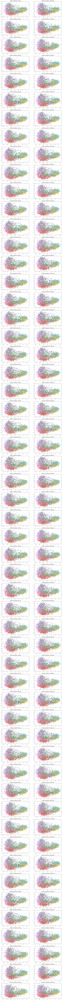

In [68]:
# finding accuracies matrix on heldout datasets
fig, ax=plt.subplots(55,2,figsize=(15,5*50))
fig_num=0
accuracy_matrix_final=[]
for data_set_num in [1,2,3,4,5,6,7,8,9,10]:
    print(data_set_num)
    accuracy_matrix={1:None,2:None,3:None,4:None,5:None,6:None,7:None,8:None,9:None,10:None}
    with open(f'task_1_models/efficient/single/pca_{1}.pkl','rb') as f:
        pca=pickle.load(f)    
    with open(f'task_1_models/efficient/single/cov_{data_set_num}.pkl','rb') as f:
        inv_cov_matrix=pickle.load(f) 
    with open(f'task_1_models/efficient/single/prototypes_{data_set_num}.pkl','rb') as f:
        prototypes=pickle.load(f) 
    for x in range(1,data_set_num+1,1):
        print('Dataset',x)
        features=get_features_group13(f'dataset/part_one_dataset/eval_data/{x}_eval_data.tar.pth')
        d=torch.load(f'dataset/part_one_dataset/eval_data/{x}_eval_data.tar.pth')
        labels=d['targets']        
        reduced_features = pca.transform(features)

        predictions=predict_lwp(reduced_features, prototypes, inv_cov_matrix)
        accuracy=accuracy_score(labels, predictions)
        print(f"Evaluation Accuracy Dataset {data_set_num}: {accuracy}")
        accuracy_matrix[x]=accuracy

        sns.scatterplot(ax=ax[fig_num][0],x=reduced_features[:,0],y=reduced_features[:,1],hue=labels,palette=sns.color_palette("tab10", 10),legend=False).set_title(f'Model {data_set_num} Dataset {x} Actual')
        sns.scatterplot(ax=ax[fig_num][1],x=reduced_features[:,0],y=reduced_features[:,1],hue=predictions,palette=sns.color_palette("tab10", 10),legend=False).set_title(f'Model {data_set_num} Dataset {x} Predicted')
        fig_num=fig_num+1
    accuracy_matrix_final.append(accuracy_matrix)
fig.savefig('task_1_models/efficient/single/result_plots_pca.png')
accuracy_matrix_final2=pd.DataFrame(accuracy_matrix_final).fillna('')
accuracy_matrix_final2.index=['model 1','model 2','model 3','model 4','model 5','model 6','model 7','model 8','model 9','model 10']
accuracy_matrix_final2.columns='dataset '+ pd.Series(accuracy_matrix_final2.columns).astype(str)
accuracy_matrix_final2 # not significant drop in previous datasets by ith model

# task 2
### Shifted to different file

In [73]:
fig.savefig('task_1_models/efficient/single/result_plots_pca.pdf',format='pdf')